In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
import copy
import cv2
import time
import numpy as np
import tabulate
import matplotlib.pyplot as plt
sys.path.append(os.path.join(os.path.abspath(""), ".."))

from app.utils import ImageWrapper
from app.custom import RemoveBusBars, Orient, BusbarMask
from app.transforms import FFT, IFFT, CreateOnesMask, PCA, DownsampleBlur, MaskedFFT
from app.filters import *
from app.imager import ImageLoader, DefectViewer, Show, Exposure

from app.models import Classifier
from sklearn.linear_model import LogisticRegression

In [25]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA as sk_PCA
from sklearn.manifold import TSNE
from matplotlib.lines import Line2D
import pandas as pd

# Plot 
def plot_comparison(reduced_clean, reduced_others, clean_labels, others_labels):
    
    reduced_clean = do_TSNE(reduced_clean)
    reduced_others = do_TSNE(reduced_others)
    
    clean_df = pd.DataFrame({'label':clean_labels})
    others_df = pd.DataFrame({'label':others_labels})
    
    colors = {'closed':'tab:blue', 'clean':'tab:orange', 'all_others':'tab:green'}
    
    
    from matplotlib.lines import Line2D
    fig, axs = plt.subplots(nrows=1,ncols=2, figsize=(12, 6))
    axs[0].scatter(reduced_clean[:,0], reduced_clean[:,1], c=clean_df['label'].map(colors), alpha=0.5)
    axs[0].set_title('Closed vs Clean')

    axs[1].scatter(reduced_others[:,0], reduced_others[:,1], c=others_df['label'].map(colors), alpha=0.3)
    handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
    axs[1].legend(title='Legend', handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')
    axs[1].set_title('Closed vs All Others')
    plt.show()
    
def do_TSNE(input_matrix):
    
    tsne_reduced = TSNE(n_components=2, perplexity=10).fit_transform(input_matrix)
    
    return tsne_reduced

## Build some pipeline functions:
def closed_pipeline(in_imgs, steps, cat):
    
    if steps == 1:
        _, out_class =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  in_imgs))
        out_class.category=f"{cat}"
    
    elif steps == 2:
        _, out_class = (ThresholdMultiotsu(classes=4, threshold=1, digitize=False)) \
            << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  in_imgs))
        out_class.category=f"{cat}"
        
    elif steps == 3:
        _, out_class = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) \
                << (ThresholdMultiotsu(classes=4, threshold=1, digitize=False) \
                    << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  in_imgs)))))
        out_class.category=f"{cat}"
    
    return out_class

def prepare_lists(obj_lists):
    labels = []

    # process labels. 
    for obj in obj_lists:
        [labels.append(obj.category) for x in range(len(obj.image_labels))]
        
        # process images
    img_list = []
    [img_list.append(obj.images) for obj in obj_lists]
    
    img_matrix = np.vstack(img_list)
    
    # Stack all images
    img_matrix_ = img_matrix.reshape(img_matrix.shape[0], img_matrix.shape[1] * img_matrix.shape[2])
    
    return img_matrix_, labels

# Seed used in show to show the same images when num_images option is set
seed = 1234

# Utility function for plotting during this EDA:
def plot_10(in_imgs):
    fig, axs = plt.subplots(2,5, figsize=(15, 6))
    fig.subplots_adjust(hspace = .5, wspace=.001)
    axs = axs.ravel()
    for i in range(10):
        axs[i].imshow(in_imgs[i], cmap='Greys_r')
        axs[i].set_title(f'{i}')
        
# Function to make masks
def create_mask(half_width, shape, mtype):
    
  # Create a vertical mask
    if mtype == 'vertical':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[1] // 2
        top_left = (midpoint - half_width, 0)
        bottom_right = (midpoint + half_width, shape[0])
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
  # Create a horizontal mask
    if mtype == 'horizontal':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[0] // 2
        top_left = (0, midpoint - half_width)
        bottom_right = (shape[1], midpoint + half_width)
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
    return in_mask

def get_n_samples(n_samples):
    
    closed = (DefectViewer() << (ImageLoader(defect_class='Closed') << n_samples))
    closed.category = 'Closed'
    clean = (DefectViewer() << (ImageLoader(defect_class='None') << n_samples))
    clean.category = 'Clean'
    all_others = (DefectViewer() << (ImageLoader(defect_class=['Resistive', 'Isolated', 'Corrosion', 'FrontGridInterruption', 'BrightSpot', 'NearSolderPad']) << n_samples))
    all_others.category = 'all_others'
    
    closed_ = closed.copy()
    closed = closed - all_others
    all_others = all_others - closed_
    clean = clean - closed_
    
    return closed, clean, all_others
    
## Stack images
def stack_images(obj_lists):
    
    #get number of images
    n_samples = obj_lists[0].images.shape[0]
    
    # Process labels
    labels = []
    for obj in obj_lists:
        [labels.append(obj.category) for x in range(n_samples)]
        
    img_list = []
    [img_list.append(obj.images) for obj in obj_lists]
    img_matrix = np.vstack(img_list)
    
    return img_matrix, labels

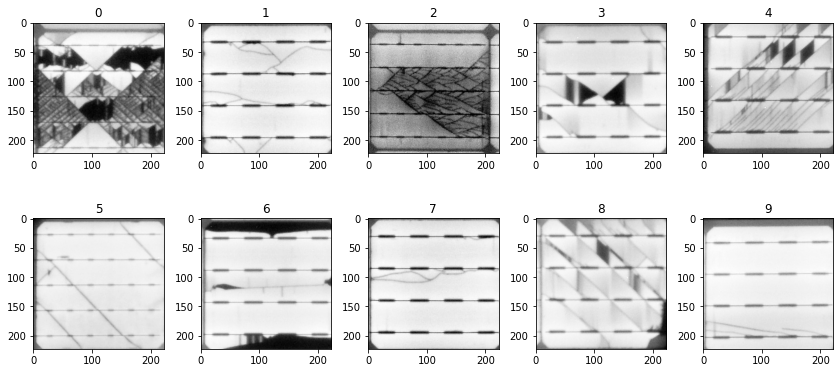

In [4]:
# Load 100 examples and name the category for it. Category is like a title for images
n_samples = 10
closed, clean, all_others = get_n_samples(n_samples)
plot_10(closed.images)

## EDA

### Description 

Isolated cracks are at their simplest thin dark likes which represent fractures in the cell wafer material. The shape of the crack is determined by the way the crack was created, and also the underlying properties of the wafer. For instance, if the wafer is multicrystalline, the cracks are generally lines which propagate in all directions, and are typically not smooth lines, since there is no underlying crystallographic plane to 'guide' the crack. 

Cracks in monocrystalline wafers are generally 'straighter', smoother lines which tend to propagate along diagonals in the wafer, due to the way that wafers are sliced along the < 1 0 0 > plane. 

Unlike isolated and resistive cracks, these cracks are characterised by the rack line only, and do not cause any isolated dark regions (isolated) or gradients (resistive) which emanate adjacent to the crack line.

Therefore we need to design filters to extract dark thin lines from the image. 

### Tested Approach

- Blur image and apply a filter such as the Sato, Frangi or Meijering filter to extract thin tube/vessel like structures. We also try a Farid edge detector. 
- Threshold out the crack lines 
- Remove any horizontal lines such as busbars which may be present. 

## Vesselness filters

In the following blocks we apply different vesselness filters with varying sigma's. Due to the different intensities of the output, we stretch the output values to 0-1. 

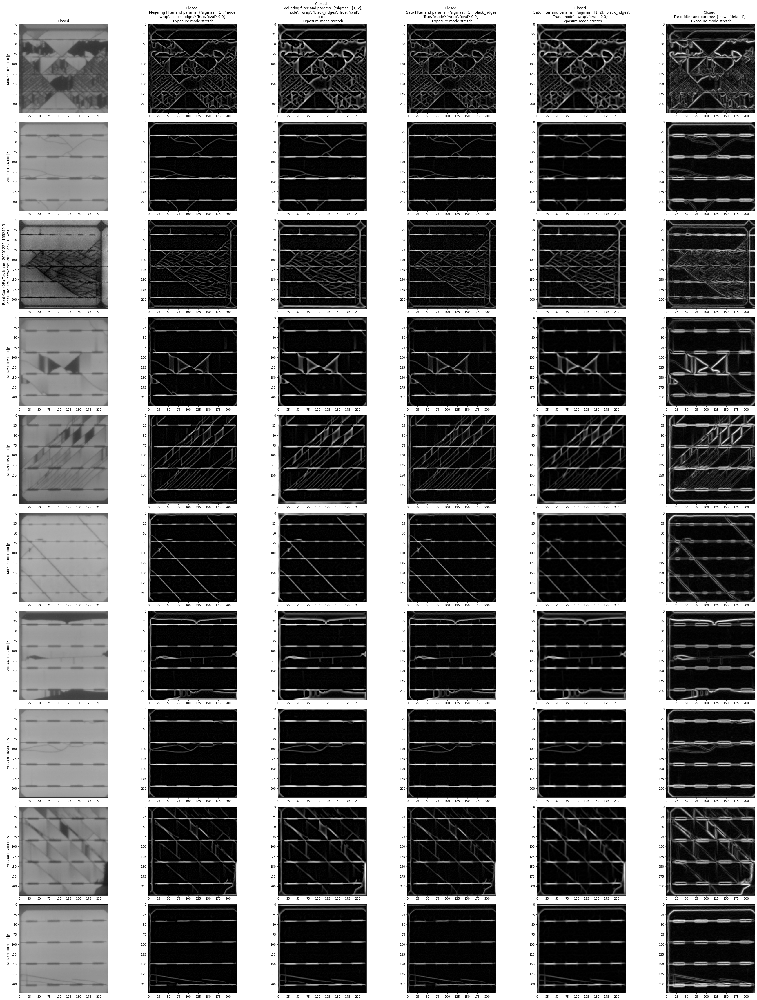

In [5]:
## Test different vesselness filters - sigma = 1,2,3 (note Farid is fixed for comparison)

_, meijering_1 = Exposure('stretch') << (Meijering(sigmas=[1]) <<  closed)
_, sato_1 = Exposure('stretch') <<(Sato(sigmas=[1]) <<  closed)
_, meijering_2 = Exposure('stretch') << (Meijering(sigmas=[1,2]) <<  closed)
_, sato_2 = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, farid = Exposure('stretch') << (Farid() <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, meijering_1, meijering_2, sato_1, sato_2, farid)

#### Comments

- The farid filter is highly effective at detecting the edges, however it is almost picking up too much features and requires further filtering before application. This is particularly relevant for the multicrystalline cells, where it is filtering the grain boundaries and clusters.
- The sato and meijiring filters work well filtering the background texture from the cracks, and using sigma of 1 and 2 seems to be superior Using sigma = 1,2 and 3(not shown), and just 1 alone.
- Looking closely, the Sato filter with sigma's 1,2 tends to pick up less background noise than the meijering filter of the same parameters.

We will continue with the Sato filter but first explore the Frangi filter, which allows for a few more parameters to be tuned including:

- alpha: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a plate-like structure. 
- beta: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a blob-like structure.
- gamma: Frangi correction constant that adjusts the filter’s sensitivity to areas of high variance/texture/structure.

[source](https://scikit-image.org/docs/stable/api/skimage.filters.html#skimage.filters.frangi)

For comparison, we also try a Canny filter.

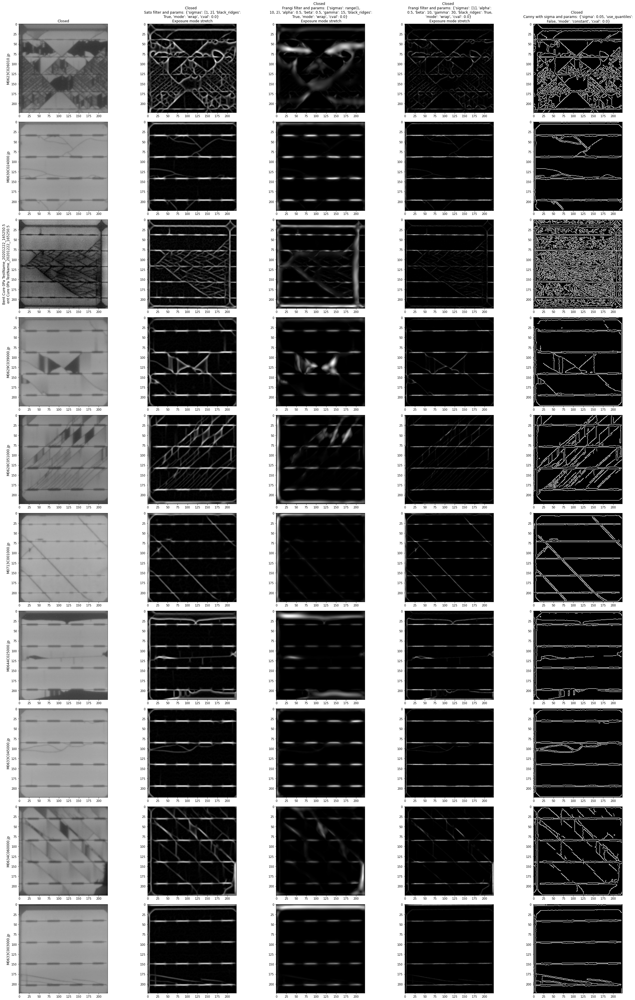

In [6]:
## Test different vesselness filters - sigma = 1,2 

_, sato = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, frangi_default = Exposure('stretch') <<(Frangi(sigmas=range(1,10,2)) <<  closed)
_, frangi_1 = Exposure('stretch') <<(Frangi(sigmas=[1], beta=10, gamma=30) <<  closed)
_, canny = (Canny(0.05) <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, sato, frangi_default, frangi_1, canny)

### Evaluation

We find that the sato and meijering filters strike the best balance crack detection, background separation and sensitivity. Despite the additional parameters of the Frangi filter, we were not able to find good parameters which matched the performane of the Sato or Meijering filter. In comparison, the Canny filter required a very small sigma to be sensitive to the thin cracks, however doing so introduced a lot of noise.

### Issues - Horizontal and Vertical Lines

Vertical lines from the cell edges, or front grid interruptions and horizontal lines from the busars are being picked up. In the case of front grid interruptions, the removal of these may help improve performance of distinguishing between these two classes. 

There are two methods which can be trialled:

- FFT filtering the horizontal and vertical magnitudes from the FFT transformed image. 
- Using kernels and morphology functions in OpenCV2. 

#### Fourier Transform

We try a fourier transformed imagge whereby we try the following masks on the transformed magnitude:

- horizontal line - to target vertical frequencies in the image
- vertical line: targets horizontal lines in the image,
- A cross: both vertical and horizontal lines in the image

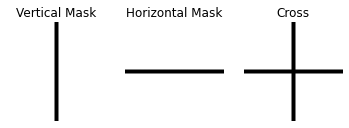

In [7]:
# Make masks
vertical = 1 - create_mask(4, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(4, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

# Plot
_, axes = plt.subplots(nrows=1, ncols=3)
axes[0].imshow(vertical, cmap='gray')
axes[0].set_axis_off()
axes[0].set_title('Vertical Mask')
axes[1].imshow(horizontal, cmap='gray')
axes[1].set_axis_off()
_ = axes[1].set_title('Horizontal Mask')
axes[2].imshow(cross, cmap='gray')
axes[2].set_axis_off()
_ = axes[2].set_title('Cross')

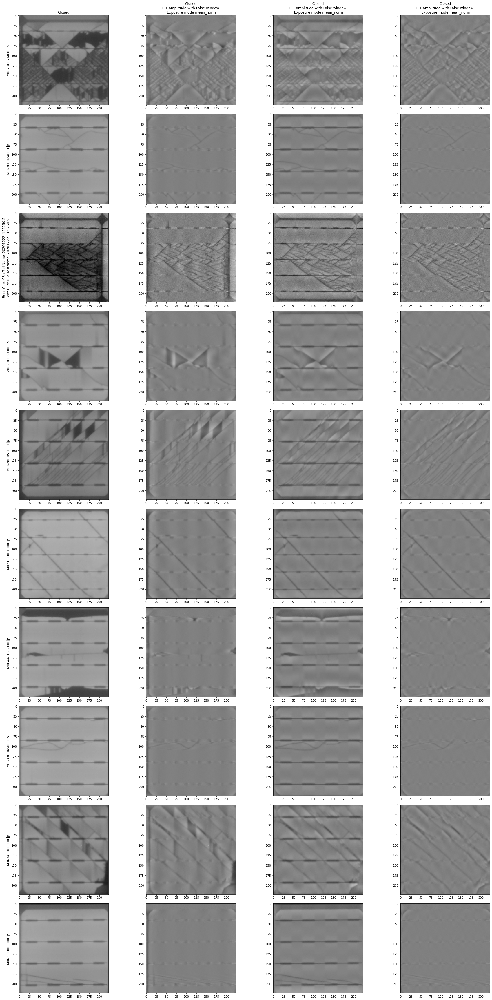

In [8]:
# Apply maks to FFT transformed image
_, vertical_ = (Exposure('mean_norm') << (MaskedFFT(mask=vertical, window=False) << closed))
_, horizontal_ = (Exposure('mean_norm') <<(MaskedFFT(mask=horizontal, window=False) << closed))
_, cross_ = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) << closed))
_ = Show(num_images=10, seed=seed) << (closed, vertical_, horizontal_, cross_)

The series of filters applied to the fourier magnitude have done a reasonable job of removing horizontal and vertical lines from the images. 

### Issue - Noise from multicrystalline 
We apply a multiotsu threshold filter in two ways - by thresholding and binarising the data, or by filtering based on the threshold levels. We observe that closed dark regions are often picked up in the image as these are bounded by edges. We try using a multiotsu filter to help isolate the crack lines without the inbetween fill.

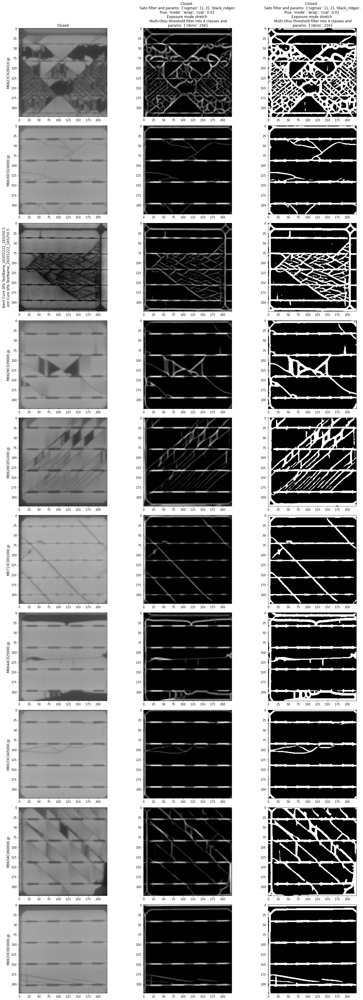

In [9]:
_, Thresholded_1 = ThresholdMultiotsu(classes=4, threshold=1, digitize=False) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))
_, Thresholded_2 = ThresholdMultiotsu(classes=4, threshold=2) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))

_ = Show(num_images=20, seed=seed) << (closed, Thresholded_1, Thresholded_2)

In the above images, we find that the mthod of thresholding and filtering the sato filtered image helps avoid the selection of features such as closed dark regions. 

## Putting it all together

We propose the following pipeline:

- Apply the sato filter to the image to highlight the vessel-like crack lines in the dataset. 
- Multiotsu threshold the image to filter the lowest level of signal, since this corresponds usually to background noise. 
- Filter out the busbars and vertical edges, to leave predominantly cracks behind. 

IN the following code, we do two comparisons:
- the defect class vs no defects present, since this represents this represents in some respects the upper limit for performance. 
- the defect class vs all other classes, since in this comparison we compare how well the features are unique to the 'closed' class.

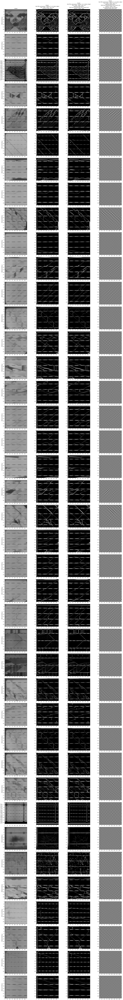

In [11]:
# Create mask
vertical = 1 - create_mask(6, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(6, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0
closed, _, _ = get_n_samples(40)

# Apply pipeline sequentially to show cumulative effect. 
_, sato_stretched =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded = (ThresholdMultiotsu(classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded_fft = (Exposure('mean_norm') << (MaskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed)))))

_ = Show(num_images=40, seed=seed) << (closed, sato_stretched, sato_thresholded, sato_thresholded_fft)

In [19]:
# Get images
n_samples = 1200
closed_2000, clean_2000, all_others_2000 = get_n_samples(n_samples)
print('Samples loaded')

# Apply transforms
closed_sato =  closed_pipeline(closed_2000, 1, 'closed')
closed_MO =  closed_pipeline(closed_2000, 2, 'closed')
closed_fft  = closed_pipeline(closed_2000, 3, 'closed') 

clean_sato =  closed_pipeline(clean_2000, 1, 'clean')
clean_MO =  closed_pipeline(clean_2000, 2, 'clean')
clean_fft  = closed_pipeline(clean_2000, 3, 'clean')  

all_others_sato =  closed_pipeline(all_others_2000, 1, "all_others")
all_others_MO =  closed_pipeline(all_others_2000, 2, "all_others")
all_others_fft  = closed_pipeline(all_others_2000, 3, "all_others")  
print("transforms complete")

# Perform transforms on the relevant groups
# No transform
vclean_matrix, vclean_labels = prepare_lists([closed_2000, clean_2000])
vao_matrix, vao_labels = prepare_lists([closed_2000, all_others_2000])
# Sato Filtering
sclean_matrix, sclean_labels = prepare_lists([closed_sato, clean_sato])
sao_matrix, sao_labels = prepare_lists([closed_sato, all_others_sato])
# Sato + Thresholding
mclean_matrix, mclean_labels = prepare_lists([closed_MO, clean_MO])
mao_matrix, mao_labels = prepare_lists([closed_MO, all_others_MO])
# Sato + Thresholding + fft
fclean_matrix, fclean_labels = prepare_lists([closed_fft, clean_fft])
fao_matrix, fao_labels = prepare_lists([closed_fft, all_others_fft])
print('processing complete')

Samples loaded
transforms complete
processing complete


### TSNE Transformed Data - no filters

In [42]:
vclean_labels = [x.lower() for x in vclean_labels]
vao_labels = [x.lower() for x in vao_labels]

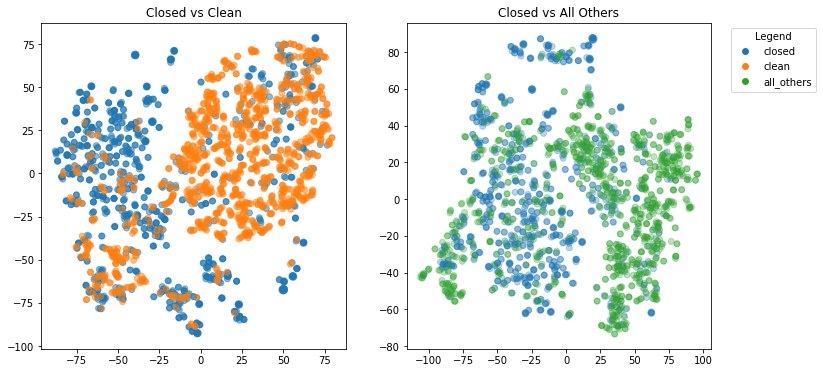

In [43]:
plot_comparison(vclean_matrix, vao_matrix, vclean_labels, vao_labels)

### TSNE Transformed Data - Sato Filter

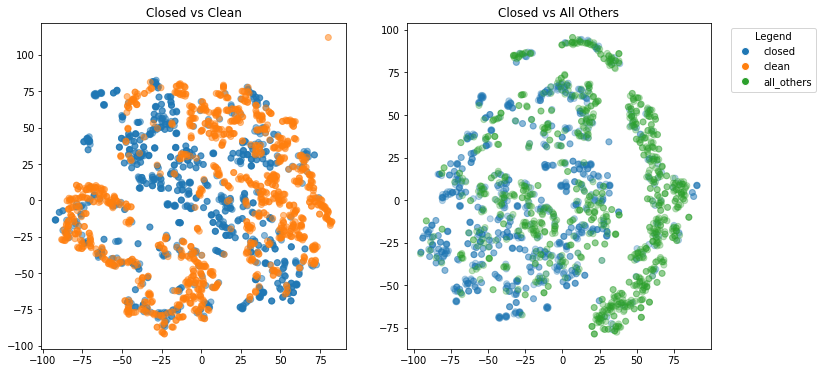

In [44]:
# Sato Filtering
plot_comparison(sclean_matrix, sao_matrix, sclean_labels, sao_labels)

### TSNE Transformed Data - Sato + MultiOtsu Thresholding Filter

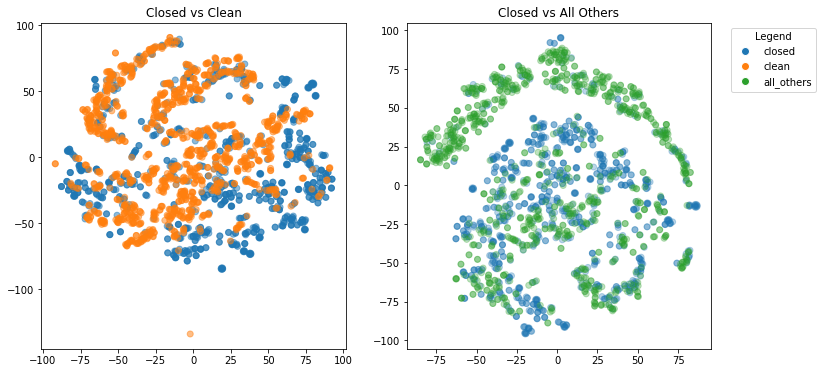

In [45]:
# Sato Filtering + Multiotsu Thresholding
plot_comparison(mclean_matrix, mao_matrix, mclean_labels, mao_labels)

### TSNE Transformed Data - Sato + MultiOtsu Thresholding + FFT Cross Filter

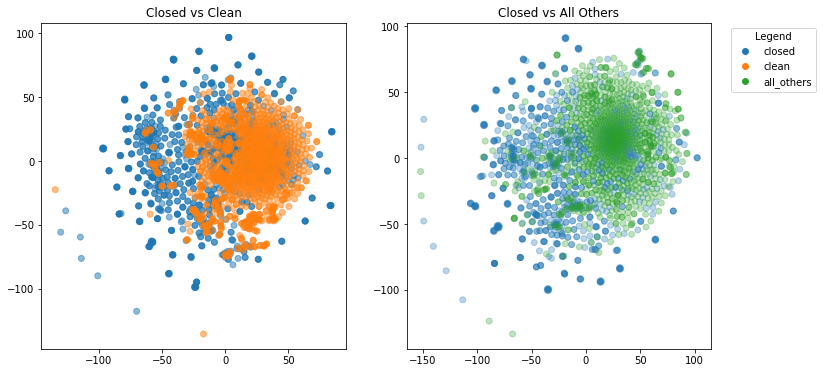

In [46]:
# Sato Filtering + MultiOtsu thresholding + FFT Cross Filter
plot_comparison(fclean_matrix, fao_matrix, fclean_labels, fao_labels)

From the above TSNE plots, we can see the the Sato and MultiOtsu threshold filters appear to increase the separation in the data. However the FFT transform appears to not help with the separation of the data, at least down to two dimensions. 

In the following section, we train classification models, evaluating the step change in performance as the filters are introduced. 

## Classifier

In [47]:
scores_clean = []
titles_clean = []

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_2000, clean_2000, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. clean')
print(score)
scores_clean.append(score)
titles_clean.append('Base model defects vs. clean')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. clean + Sato
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_sato, clean_sato, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. clean + Sato')
print(score)
scores_clean.append(score)
titles_clean.append('Base model defects vs. clean + Sato')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean + Sato + MultiOtsu
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_MO, clean_MO, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. clean + Sato + Thresholding')
print(score)
scores_clean.append(score)
titles_clean.append('Base model defects vs. clean + Sato + Thresholding')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean + Sato + MultiOtsu
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_fft, clean_fft, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. clean + Sato + Thresholding + FFT')
print(score)
scores_clean.append(score)
titles_clean.append('Base model defects vs. clean + Sato + Thresholding + FFT')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))



Base model defects vs. clean
0.85297657425317
          Pred 0    Pred 1
------  --------  --------
True 0       211        24
True 1        38       160

Base model defects vs. clean + Sato
0.8547066408768536
          Pred 0    Pred 1
------  --------  --------
True 0       213        22
True 1        39       159

Base model defects vs. clean + Sato + Thresholding
0.8487212551042338
          Pred 0    Pred 1
------  --------  --------
True 0       209        26
True 1        38       160

Base model defects vs. clean + Sato + Thresholding + FFT
0.8007414571244358
          Pred 0    Pred 1
------  --------  --------
True 0       209        26
True 1        57       141


In [49]:
scores_ao = []
titles_ao = []

# Base model on raw data - single all_others vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_2000, all_others_2000, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. all others')
print(score)
scores_ao.append(score)
titles_ao.append('Base model defects vs. all others')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. all_others + Sato
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_sato, all_others_sato, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. all others + Sato')
print(score)
scores_ao.append(score)
titles_ao.append('Base model defects vs. all others + Sato')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_MO, all_others_MO, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. all others + Sato + Thresholding')
print(score)
scores_ao.append(score)
titles_ao.append('Base model defects vs. all others + Sato + Thresholding')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_fft, all_others_fft, LogisticRegression, None)
score = cla.fit_cv(**model_params)
print('\nBase model defects vs. all others + Sato + Thresholding + FFT')
print(score)
scores_ao.append(score)
titles_ao.append('Base model defects vs. all others + Sato + Thresholding + FFT')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Base model defects vs. all others
0.8278994524639124
          Pred 0    Pred 1
------  --------  --------
True 0       170        35
True 1        34       162

Base model defects vs. all others + Sato
0.8101543056246889
          Pred 0    Pred 1
------  --------  --------
True 0       169        36
True 1        40       156

Base model defects vs. all others + Sato + Thresholding
0.8074912891986062
          Pred 0    Pred 1
------  --------  --------
True 0       170        35
True 1        42       154

Base model defects vs. all others + Sato + Thresholding + FFT
0.7672349427575909
          Pred 0    Pred 1
------  --------  --------
True 0       165        40
True 1        53       143


In [50]:
from sklearn.cluster import KMeans

scores_clean = []
titles_clean = []

# Base model on raw data - single all_others vs. clean
model_params = {'n_clusters': 2, 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_2000, clean_2000, KMeans, None)
score = cla.fit_cv(**model_params)
print('\nKMeans model defects vs. clean')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. clean')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. all_others + Sato
cla = Classifier(closed_sato, clean_sato, KMeans, None)
score = cla.fit_cv(**model_params)
print('\nKMeans model defects vs. clean + Sato')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. clean + Sato')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_MO, clean_MO, KMeans, None)
score = cla.fit_cv(**model_params)
print('\nKMeans model defects vs. clean + Sato + Thresholding')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. clean + Sato + Thresholding')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_fft, clean_fft, KMeans, None)
score = cla.fit_cv(**model_params)
print('\KMeans model defects vs. clean + Sato + Thresholding + FFT')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. clean + Sato + Thresholding + FFT')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


KMeans model defects vs. clean
0.7757253384912959
          Pred 0    Pred 1
------  --------  --------
True 0       183        52
True 1        45       153

KMeans model defects vs. clean + Sato
0.43788953363421446
          Pred 0    Pred 1
------  --------  --------
True 0        80       155
True 1        92       106

KMeans model defects vs. clean + Sato + Thresholding
0.5574575542660649
          Pred 0    Pred 1
------  --------  --------
True 0       154        81
True 1       107        91
\KMeans model defects vs. clean + Sato + Thresholding + FFT
0.5115839243498818
          Pred 0    Pred 1
------  --------  --------
True 0       136        99
True 1       110        88


In [51]:
from sklearn.cluster import KMeans

scores_ao = []
titles_ao = []

# Base model on raw data - single all_others vs. clean
model_params = {'n_clusters': 2, 'seed': 4156, 'pca_dims': 800, 'max_iter':400}
cla = Classifier(closed_2000, all_others_2000, KMeans, None)
score = cla.fit_cv(**model_params)
print('\nKMeans model defects vs. all others')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. all others')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. all_others + Sato
cla = Classifier(closed_sato, all_others_sato, KMeans, None)
score = cla.fit_cv(**model_params)
print('\nKMeans model defects vs. all others + Sato')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. all others + Sato')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_MO, all_others_MO, KMeans, None)
score = cla.fit_cv(**model_params)
print('\nKMeans model defects vs. all others + Sato + Thresholding')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. all others + Sato + Thresholding')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_fft, all_others_fft, KMeans, None)
score = cla.fit_cv(**model_params)
print('\KMeans model defects vs. all others + Sato + Thresholding + FFT')
print(score)
scores_ao.append(score)
titles_ao.append('KMeans model defects vs. all others + Sato + Thresholding + FFT')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


KMeans model defects vs. all others
0.7620457939273271
          Pred 0    Pred 1
------  --------  --------
True 0       143        62
True 1        34       162

KMeans model defects vs. all others + Sato
0.3452339472374315
          Pred 0    Pred 1
------  --------  --------
True 0        38       167
True 1        97        99

KMeans model defects vs. all others + Sato + Thresholding
0.6421229467396715
          Pred 0    Pred 1
------  --------  --------
True 0       166        39
True 1       103        93
\KMeans model defects vs. all others + Sato + Thresholding + FFT
0.39451219512195124
          Pred 0    Pred 1
------  --------  --------
True 0         8       197
True 1        49       147


In [52]:
from sklearn.ensemble import GradientBoostingClassifier

scores_clean = []
titles_clean = []

# Base model on raw data - single defect vs. clean
model_params = {'seed': 14376,'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.1, 'pca_dims': 1000}
cla = Classifier(closed_2000, clean_2000, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. clean')
print(score)
scores_clean.append(score)
titles_clean.append('GradientBoosted model defects vs. clean')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. clean + Sato
cla = Classifier(closed_sato, clean_sato, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. clean + Sato')
print(score)
scores_clean.append(score)
titles_clean.append('GradientBoosted model defects vs. clean + Sato')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean + Sato + MultiOtsu
cla = Classifier(closed_MO, clean_MO, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. clean + Sato + Thresholding')
print(score)
scores_clean.append(score)
titles_clean.append('GradientBoosted model defects vs. clean + Sato + Thresholding')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean + Sato + MultiOtsu
cla = Classifier(closed_fft, clean_fft, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. clean + Sato + Thresholding + FFT')
print(score)
scores_clean.append(score)
titles_clean.append('GradientBoosted model defects vs. clean + Sato + Thresholding + FFT')
# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))



GradientBoosted model defects vs. clean
0.8772446021375102
          Pred 0    Pred 1
------  --------  --------
True 0       232        10
True 1        39       152

GradientBoosted model defects vs. clean + Sato
0.8488598502877418
          Pred 0    Pred 1
------  --------  --------
True 0       236         6
True 1        53       138

GradientBoosted model defects vs. clean + Sato + Thresholding
0.8467937345852624
          Pred 0    Pred 1
------  --------  --------
True 0       235         7
True 1        53       138

GradientBoosted model defects vs. clean + Sato + Thresholding + FFT
0.8080784042230973
          Pred 0    Pred 1
------  --------  --------
True 0       234         8
True 1        67       124


In [55]:
scores_ao = []
titles_ao = []

# Base model on raw data - single all_others vs. clean
model_params = {'seed': 14376,'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.1, 'pca_dims': 1000}
cla = Classifier(closed_2000, all_others_2000, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. all others')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others')
# Misclassified
conf, out_0 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. all_others + Sato
cla = Classifier(closed_sato, all_others_sato, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. all others + Sato')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others + Sato')
# Misclassified
conf, out_1 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_MO, all_others_MO, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. all others + Sato + Thresholding')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others + Sato + Thresholding')
# Misclassified
conf, out_2 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_fft, all_others_fft, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\GradientBoosted model defects vs. all others + Sato + Thresholding + FFT')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others + Sato + Thresholding + FFT')
# Misclassified
conf, out_3 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


GradientBoosted model defects vs. all others
0.8195048762190547
          Pred 0    Pred 1
------  --------  --------
True 0       179        36
True 1        36       150

GradientBoosted model defects vs. all others + Sato
0.8015628907226806
          Pred 0    Pred 1
------  --------  --------
True 0       184        31
True 1        47       139

GradientBoosted model defects vs. all others + Sato + Thresholding
0.8076644161040261
          Pred 0    Pred 1
------  --------  --------
True 0       182        33
True 1        43       143
\GradientBoosted model defects vs. all others + Sato + Thresholding + FFT
0.7995373843460865
          Pred 0    Pred 1
------  --------  --------
True 0       197        18
True 1        59       127


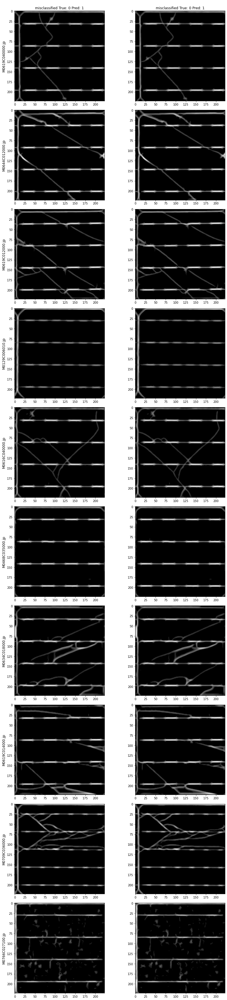

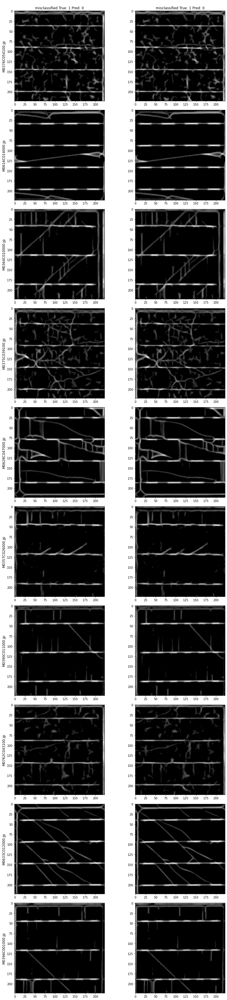

In [56]:
for misclass in out_2:
    _ = Show(num_images=10, seed=seed) << misclass

Looking at the Misclassified samples, it's difficult to discern the issue

In [135]:
scores_ao = []
titles_ao = []

# Base model on raw data - single all_others vs. clean
model_params = {'seed': 14376,'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.1, 'pca_dims': None}
cla = Classifier(closed_2000, all_others_2000, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. clean')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others')
# Misclassified
conf, out_0 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. all_others + Sato
cla = Classifier(closed_sato, all_others_sato, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. clean + Sato')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others + Sato')
# Misclassified
conf, out_1 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_MO, all_others_MO, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\nGradientBoosted model defects vs. clean + Sato + Thresholding')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others + Sato + Thresholding')
# Misclassified
conf, out_2 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. all_others + Sato + MultiOtsu
cla = Classifier(closed_fft, all_others_fft, GradientBoostingClassifier, None)
score = cla.fit_cv(**model_params)
print('\GradientBoosted model defects vs. clean + Sato + Thresholding + FFT')
print(score)
scores_ao.append(score)
titles_ao.append('GradientBoosted model defects vs. all others + Sato + Thresholding + FFT')
# Misclassified
conf, out_3 = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

KeyboardInterrupt: 

In [ ]:
for misclass in out_2:
    _ = Show(num_images=5, seed=seed) << misclass